---
CHARGEMENT DATA ET CONFIG
---

In [4]:
import pandas as pd
import numpy as np
# chemin vers le DATASET ou les DATASETS
import os
for dirname, _, filenames in os.walk('../data/raw/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

../data/raw/datatest.csv
../data/raw/powerconsumption.csv


In [5]:
file_name  = "../data/raw/powerconsumption.csv"
df = pd.read_csv(file_name)
df.head()

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3
0,1/1/2017 0:00,6.559,73.8,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386
1,1/1/2017 0:10,6.414,74.5,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434
2,1/1/2017 0:20,6.313,74.5,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373
3,1/1/2017 0:30,6.121,75.0,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711
4,1/1/2017 0:40,5.921,75.7,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964


In [6]:
# information basique du datasets comme type de donnee pour colonne
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52416 entries, 0 to 52415
Data columns (total 9 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Datetime                52416 non-null  object 
 1   Temperature             52416 non-null  float64
 2   Humidity                52416 non-null  float64
 3   WindSpeed               52416 non-null  float64
 4   GeneralDiffuseFlows     52416 non-null  float64
 5   DiffuseFlows            52416 non-null  float64
 6   PowerConsumption_Zone1  52416 non-null  float64
 7   PowerConsumption_Zone2  52416 non-null  float64
 8   PowerConsumption_Zone3  52416 non-null  float64
dtypes: float64(8), object(1)
memory usage: 3.6+ MB


In [7]:
# shape du dataframe
df.shape

(52416, 9)

- Date Heure : Fenêtre temporelle de dix minutes.
- Température : Température météorologique.
- Humidité : Humidité météorologique.
- Vitesse du vent : Vitesse du vent.
- Écoulements diffus généraux : « Écoulement diffus » est un terme générique pour décrire les fluides à basse température (< 0,2° à ~ 100°C) qui s'écoulent lentement à travers des monticules de sulfures, des coulées de lave fracturées et des assemblages de tapis bactériens et de macrofaune.
- Flux diffus
- Consommation d'énergie en zone 1
- Consommation d'énergie en zone 2
- Consommation d'énergie en zone 3


---
PRE TRAITEMENT DES DATAS
---

Problématique : Le dataset contient 9 colonnes dont 3 sont nos variables cibles (target var), pour le projet école nous allons créer une 10 ème colonne pour centraliser la moyenne conso electrique des 3 zones par observation (ligne). (PowerConsumption_Zone) 

In [8]:
# création 10eme colonne = Moyenne de PowerConsumption_Zone1, 2 et 3. (???aide à diriger le choix MODELE MACHINE LEARNING???)
df['PowerConsumption_Zone'] = df[['PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3']].mean(axis=1)
df.head(-10)

,Datetime,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,PowerConsumption_Zone
0,1/1/2017 0:00,6.559,73.80,0.083,0.051,0.119,34055.69620,16128.87538,20240.96386,23475.178480
1,1/1/2017 0:10,6.414,74.50,0.083,0.070,0.085,29814.68354,19375.07599,20131.08434,23106.947957
2,1/1/2017 0:20,6.313,74.50,0.080,0.062,0.100,29128.10127,19006.68693,19668.43373,22601.073977
3,1/1/2017 0:30,6.121,75.00,0.083,0.091,0.096,28228.86076,18361.09422,18899.27711,21829.744030
4,1/1/2017 0:40,5.921,75.70,0.081,0.048,0.085,27335.69620,17872.34043,18442.40964,21216.815423
...,...,...,...,...,...,...,...,...,...,...
52401,12/30/2017 21:30,7.950,70.20,0.082,0.062,0.085,35297.33840,30852.40871,16589.67587,27579.807660
52402,12/30/2017 21:40,7.650,71.10,0.082,0.084,0.093,34591.63498,30347.95950,16485.95438,27141.849620
52403,12/30/2017 21:50,8.140,69.73,0.081,0.062,0.085,34469.96198,29688.86161,16180.55222,26779.791937
52404,12/30/2017 22:00,8.090,68.49,0.079,0.070,0.085,34920.15209,29445.84228,16053.78151,26806.591960


Solution : PowerConsumption_Zone sera notre variable cible "target" ou "y", les 9 autres variables seront les "inputs" ou "x"

---

NOUVEAU PROBLEME POSE : Avec notre jeu de données, nous sommes confrontés à un problème de REGRESSION étant donné que "target" = colonne NUMERIQUE

---
NETTOYAGE DES DONNEES
---

In [9]:
# version josé ahmed
percent_null= df.isnull().sum()*100 / len(df)
percent_null.sort_values(ascending=False,inplace=True)

percent_null.head(10)

Datetime                  0.0
Temperature               0.0
Humidity                  0.0
WindSpeed                 0.0
GeneralDiffuseFlows       0.0
DiffuseFlows              0.0
PowerConsumption_Zone1    0.0
PowerConsumption_Zone2    0.0
PowerConsumption_Zone3    0.0
PowerConsumption_Zone     0.0
dtype: float64

In [10]:
# analyse valeurs manquantes
df.isna().sum()

Datetime                  0
Temperature               0
Humidity                  0
WindSpeed                 0
GeneralDiffuseFlows       0
DiffuseFlows              0
PowerConsumption_Zone1    0
PowerConsumption_Zone2    0
PowerConsumption_Zone3    0
PowerConsumption_Zone     0
dtype: int64

In [11]:
# analyse valeurs doublons
df.duplicated().sum()

np.int64(0)

---
VISUALISATION analyse DESCRIPTIVE ET DISTRIBUTION
---

In [12]:
# STATISTIQUES DESCRIPTIVES avec pandas
df.describe()

# GENERATION BDD BRUTE #################################################### ATTENTION !!!!
# Exporter en fichier CSV
# df.to_csv("../data/processed/new_power_consumption.csv", index=False)  # index=False pour ne pas inclure l'index

# print("Fichier CSV généré : power_consumption.csv")


,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,PowerConsumption_Zone
count,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000,52416.000000
mean,18.810024,68.259518,1.959489,182.696614,75.028022,32344.970564,21042.509082,17835.406218,23740.961955
std,5.815476,15.551177,2.348862,264.400960,124.210949,7130.562564,5201.465892,6622.165099,5714.379655
min,3.247000,11.340000,0.050000,0.004000,0.011000,13895.696200,8560.081466,5935.174070,12261.679913
25%,14.410000,58.310000,0.078000,0.062000,0.122000,26310.668692,16980.766032,13129.326630,18833.024880
50%,18.780000,69.860000,0.086000,5.035500,4.456000,32265.920340,20823.168405,16415.117470,23262.930313
75%,22.890000,81.400000,4.915000,319.600000,101.000000,37309.018185,24713.717520,21624.100420,27916.390770
max,40.010000,94.800000,6.483000,1163.000000,936.000000,52204.395120,37408.860760,47598.326360,44736.048650


In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.graph_objects as go
import plotly.subplots as sp

# visualisation des STATS DESCRIPTIVES
all_column_stats = df.describe()

# drop des lignes count, min, max pour une visualisation barres histogrammes des statistiques descriptives par VARIABLES 
all_column_stats = all_column_stats.drop(['count', 'min', 'max'])

# Create a 3x3 grid of bar plots using Plotly
fig = sp.make_subplots(rows=3, cols=3, subplot_titles=all_column_stats.columns)

# Iterate over each column
for i, column in enumerate(all_column_stats.columns):
    row_num = i // 3 + 1
    col_num = i % 3 + 1
    
    # Select column statistics
    column_stats = all_column_stats[column]
    
    # Add bar trace to the subplot
    fig.add_trace(
        go.Bar(
            x=column_stats.index,
            y=column_stats.values,
            marker_color=px.colors.qualitative.Set2, # palette de couleur Set1, 2, 3
            texttemplate='%{y:.2s}',
            textposition='outside',
        ),
        row=row_num,
        col=col_num,
    )
    
    # Update subplot layout
    fig.update_layout(
#         xaxis_title=f'Descriptive Statistics for {column}',
        yaxis_title='Valeurs',
    )

# Update layout for the entire figure
fig.update_layout(showlegend=False, height=1000, width=900, title_text="Statistiques decriptives (tirées du 'describe()')")
fig.show()

---
ANALYSE 

- Sur 1 an la tempé moyenne = 19°C sur la VILLE Tétouan et il fait plutôt humide
- Sur la dernière colonne, notre variable target, les statistiques descriptives montrent un écart-type confirmant une faible variabilité des données.
- Moyenne conso elec sur les 3 ZONES (ville de Tetouan) au total : 24k

In [14]:
# visualisation de la distribution
columns = list(df.columns)[1:10]

fig = sp.make_subplots(rows=3, cols=3, subplot_titles=[f'{column}' for column in columns])

for i, column in enumerate(columns):
    row, col = divmod(i, 3)  # Calculate the row and column index
    histogram = go.Histogram(x=df[column], name=column)
    fig.add_trace(histogram, row=row + 1, col=col + 1)

fig.update_layout(height=500, width=950, title_text="Distribution des données")
fig.update_xaxes(tickangle=45)  # Rotate x-axis labels

fig.show()

---
ANALYSE SOMMAIRE RAPIDE

- On peut voir les min et max (direct en x).
- Moyenne conso elec sur les 3 ZONES (ville de Tetouan) au total : 24k (voir graphe précédent)
- Sur la distribution PowerConsumption_Zone on peut situé vulgairement cette moyenne conso avec la superposition des zone1, 2 et 3.
- Que les flux de fluides flows et que la vitesse du vent n'ont pas trop d'impact sur la distribution de la consommation elec.

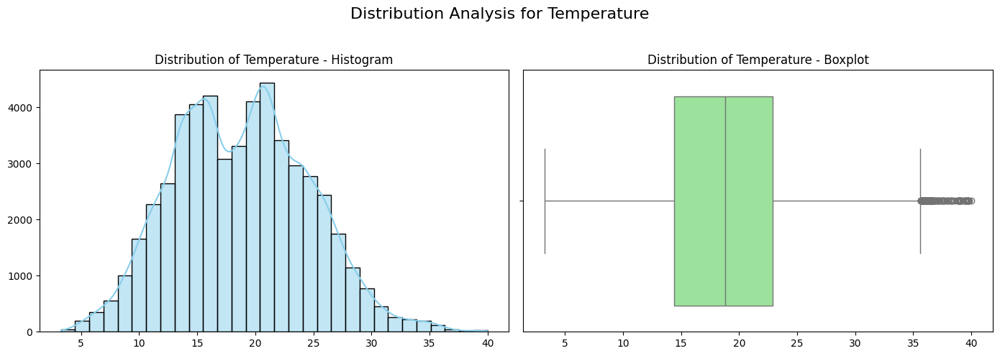

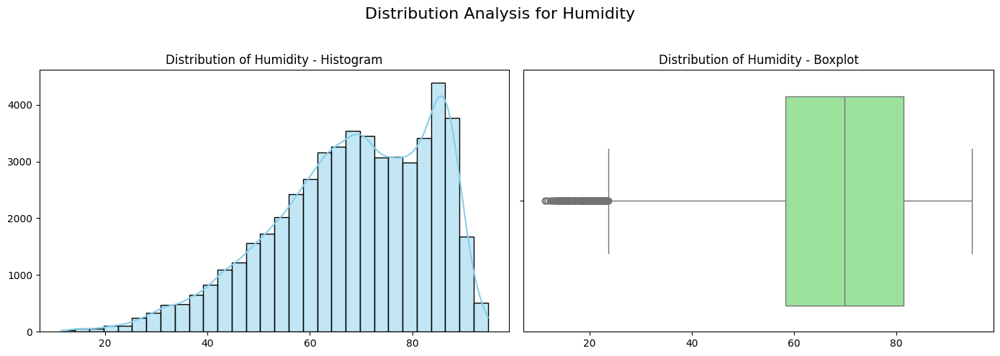

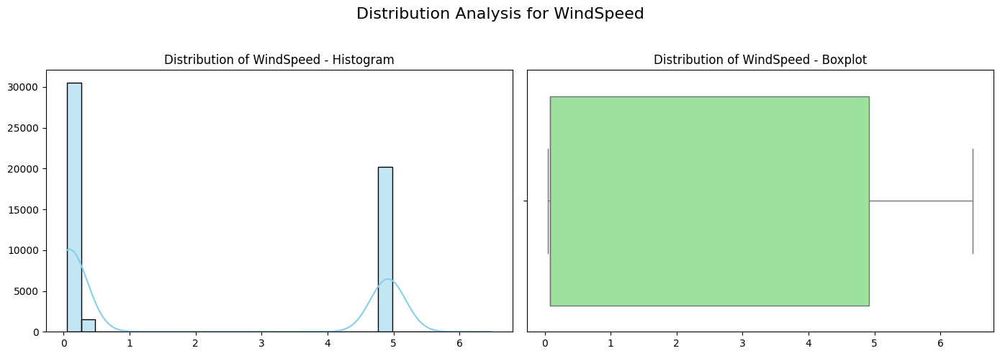

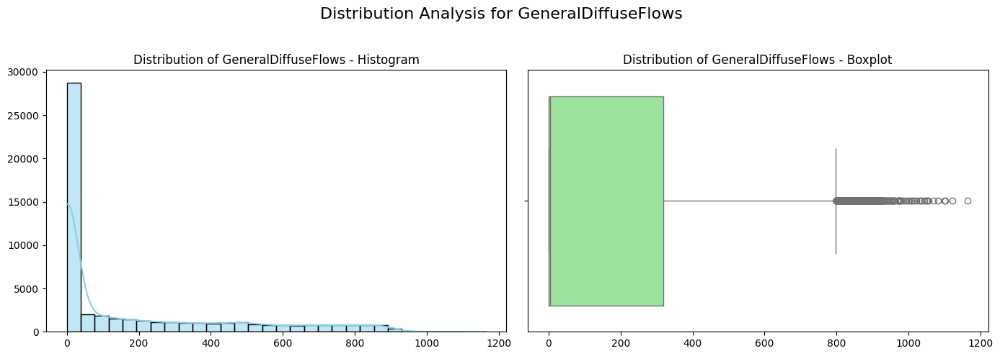

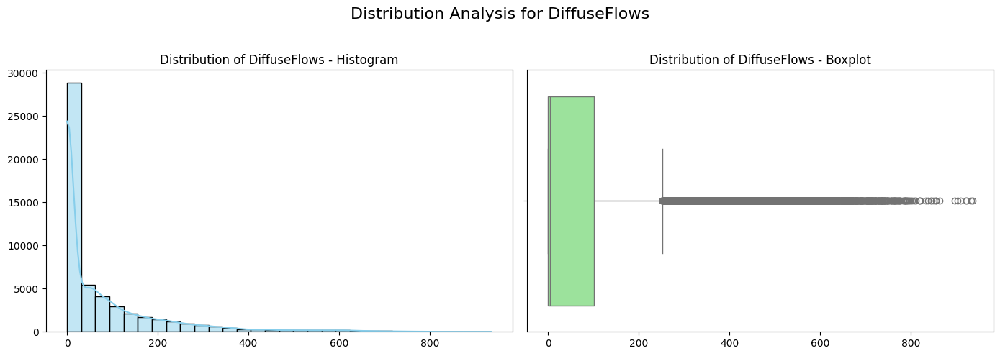

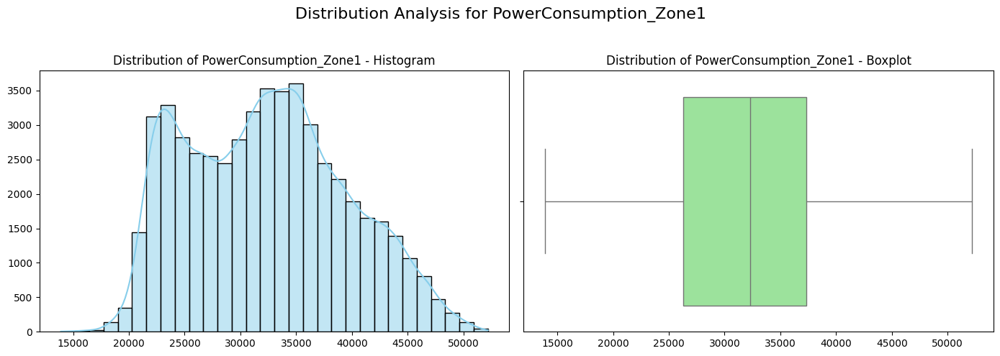

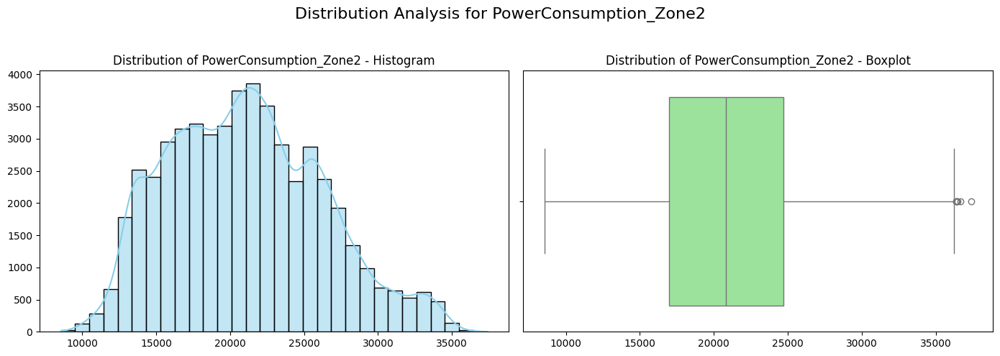

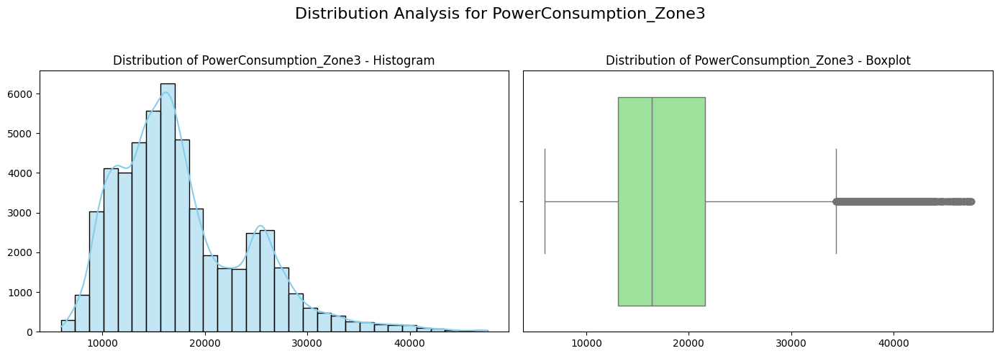

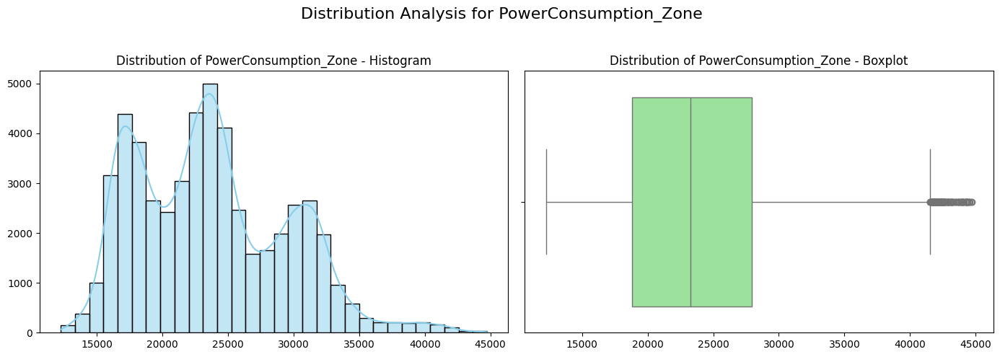

In [15]:
# VISUALISATION josé et ahmed, fonction pour visualiser chaque colonne et analyser la DISTRIBUTION (histogramme + boxplot (barre moustache pour outliers))
def plot_all_numerique(data):
    # Filtre les columns numeriques
    numeric_cols = data.select_dtypes(include='number').columns

    for col in numeric_cols:
        plt.figure(figsize=(14, 5))  # Taille des graphes

        # Histograme con KDE
        plt.subplot(1, 2, 1)
        sns.histplot(data[col], kde=True, bins=30, color='skyblue')
        plt.title(f'Distribution of {col} - Histogram')  # Títre específique
        plt.xlabel('')  # axis X vide
        plt.ylabel('')  # axis  Y vide

        # Boxplot
        plt.subplot(1, 2, 2)
        sns.boxplot(x=data[col], color='lightgreen')
        plt.title(f'Distribution of {col} - Boxplot')  # Títre específique
        plt.xlabel('')  # # axis X vide
        plt.ylabel('')  # # axis Y vide

        plt.suptitle(f'Distribution Analysis for {col}', fontsize=16)  # Títre general
        plt.tight_layout(rect=[0, 0, 1, 0.95])  # Ajuste l'espace du titre
        plt.show()

# accède à la visualisation par APPEL
plot_all_numerique(df)

In [16]:
# analyse du WindSpeed pour voir plus clairement son comportement (traitement analyse test)
colonne_a_visualiser = df.columns
print(colonne_a_visualiser)

Index(['Datetime', 'Temperature', 'Humidity', 'WindSpeed',
       'GeneralDiffuseFlows', 'DiffuseFlows', 'PowerConsumption_Zone1',
       'PowerConsumption_Zone2', 'PowerConsumption_Zone3',
       'PowerConsumption_Zone'],
      dtype='object')


In [17]:
df.WindSpeed.value_counts()

WindSpeed
0.082    2291
0.083    1979
0.084    1831
0.081    1804
0.085    1513
         ... 
3.739       1
1.855       1
2.442       1
4.655       1
2.766       1
Name: count, Length: 548, dtype: int64

<Axes: xlabel='WindSpeed', ylabel='Count'>

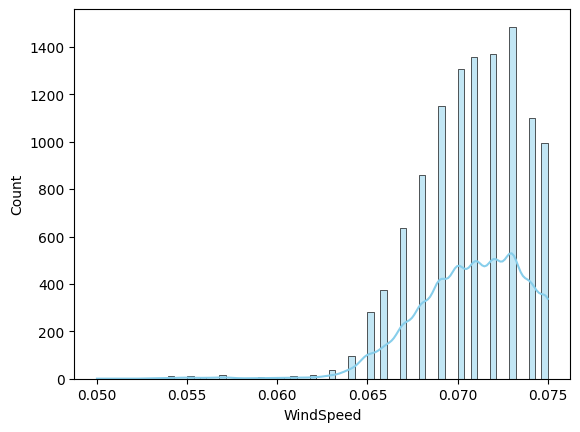

In [18]:
sns.histplot(df.WindSpeed[df.WindSpeed<0.076] ,kde=True, bins=70, color='skyblue')

---
ANALYSE SOMMAIRE RAPIDE

- L'analyse du WindSpeed : on analyse la distribution des valeurs sur les points aux poids importants, 0.86 et 4.19 (voir histogramme des stats descriptives)
- Contrairement à la température où la distribution est plus significative, pour le WindSpeed il est nécéssaire de lever les doutes sur les hypothèses.

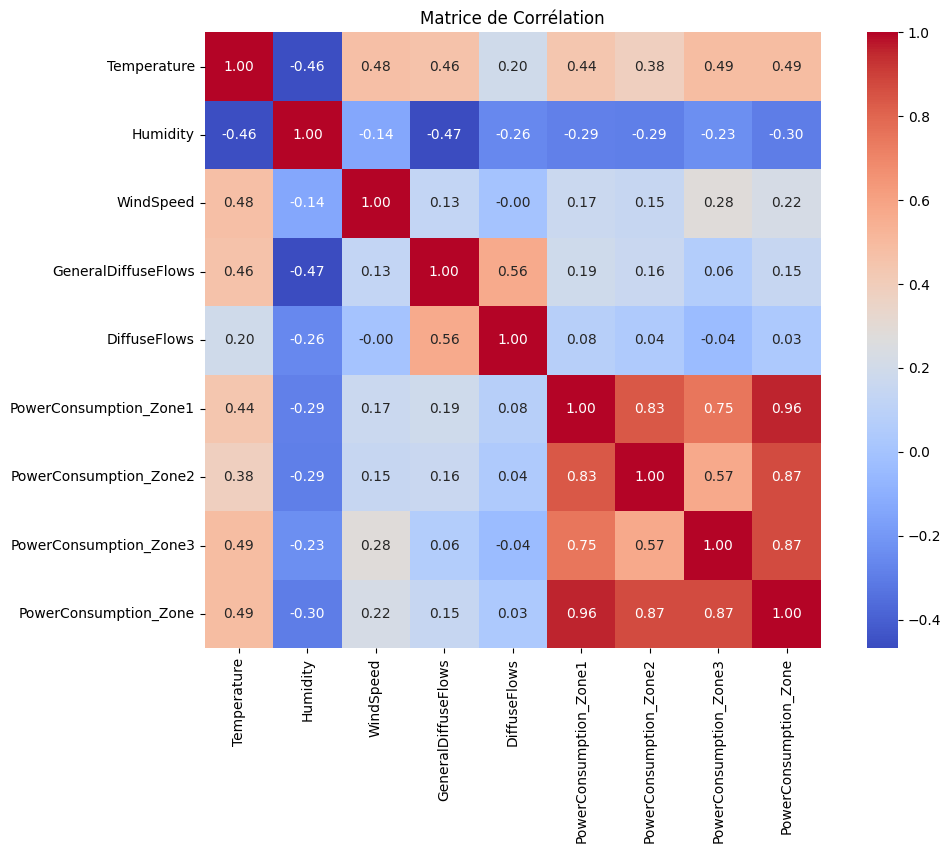

In [19]:
# visualisation MATRIX de CORRELATION
correlation_matrix = df.drop('Datetime',axis = 1).corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title('Matrice de Corrélation')
plt.show()

---
ANALYSE SOMMAIRE RAPIDE

- Ce code crée une matrice de corrélation pour les colonnes numériques du DataFrame (sauf la colonne 'Datetime') et la visualise à l'aide d'une heatmap (carte thermique) avec Seaborn.
- Les couleurs :
* Rouge foncé : Corrélation positive élevée (près de 1). La variable augmente tandis que les autres "aussi"
* Bleu foncé : Corrélation négative élevée (près de -1). Plus la variable augmente plus les autres diminuent (inverse corrélation négative parfaite)
* Blanc : Corrélation proche de 0. Aucune corrélation

- Le vent et les diffuse flows n'ont pas de corrélation avec les variables cibles qu'on veux prédire. 
- La température est corrélée sur tout le jeu de donnée.
-L'humidité possède une corrélation NEG qui montre qu'il y a une grande consommation electrique des foyers lorsque l'humidité baisse, à l'inverse la conso baisse quand l'humidité tend à augmenter. Ce qui n'est pas totalement vrai. C'est une tendance...

In [20]:
# analyse du Température / Humidité / Windspeed pour voir plus clairement leurs comportements (traitement analyse test) vis à vis de la target (PowerConsumption_Zone)
# visualisation par scatter plot et box plot pour voir les percentils + affichage de la ligne de tendance globale (trendline)
fig = px.scatter(df, x='Temperature', y='PowerConsumption_Zone',
                 title='Scatter Plot: Power Consumption Zone  vs Temperature',
                 labels={'PowerConsumption_Zone': 'Power Consumption Zone '},
                 color_discrete_sequence=['blue'],  # Specify color for the dots
                 marginal_y='box',  # Display box plot on the y-axis
                 )

# Manually add a trendline using NumPy for linear regression
fit = np.polyfit(df['Temperature'], df['PowerConsumption_Zone'], 1)
trendline_y = np.polyval(fit, df['Temperature'])

# Add scatter plot trace
fig.add_scatter(x=df['Temperature'], y=df['PowerConsumption_Zone'],
                mode='markers', marker=dict(color='blue'), name='Scatter Points')

# Add trendline trace
fig.add_scatter(x=df['Temperature'], y=trendline_y,
                mode='lines', line=dict(color='green'), name='Trendline')

# Customize the layout if needed
fig.update_layout(xaxis_title='Temperature', yaxis_title='Power Consumption Zone ')
# Show the plot
fig.show()


In [21]:
fig = px.scatter(df, x='Humidity', y='PowerConsumption_Zone',
                 title='Scatter Plot: Power Consumption Zone  vs Humidity',
                 labels={'PowerConsumption_Zone': 'Power Consumption Zone '},
                 color_discrete_sequence=['blue'],  # Specify color for the dots
                 marginal_y='box',  # Display box plot on the y-axis
                 )

# Manually add a trendline using NumPy for linear regression
fit = np.polyfit(df['Humidity'], df['PowerConsumption_Zone'], 1)
trendline_y = np.polyval(fit, df['Humidity'])

# Add scatter plot trace
fig.add_scatter(x=df['Humidity'], y=df['PowerConsumption_Zone'],
                mode='markers', marker=dict(color='blue'), name='Scatter Points')

# Add trendline trace
fig.add_scatter(x=df['Humidity'], y=trendline_y,
                mode='lines', line=dict(color='green'), name='Trendline')

# Customize the layout if needed
fig.update_layout(xaxis_title='Humidity', yaxis_title='Power Consumption Zone ')
# Show the plot
fig.show()


In [22]:
fig = px.scatter(df, x='WindSpeed', y='PowerConsumption_Zone',
                 title='Scatter Plot: Power Consumption Zone  vs WindSpeed',
                 labels={'PowerConsumption_Zone': 'Power Consumption Zone '},
                 color_discrete_sequence=['blue'],  # Specify color for the dots
                 marginal_y='box',  # Display box plot on the y-axis
                 )

# Manually add a trendline using NumPy for linear regression
fit = np.polyfit(df['WindSpeed'], df['PowerConsumption_Zone'], 1)
trendline_y = np.polyval(fit, df['WindSpeed'])

# Add scatter plot trace
fig.add_scatter(x=df['WindSpeed'], y=df['PowerConsumption_Zone'],
                mode='markers', marker=dict(color='blue'), name='Scatter Points')

# Add trendline trace
fig.add_scatter(x=df['WindSpeed'], y=trendline_y,
                mode='lines', line=dict(color='green'), name='Trendline')

# Customize the layout if needed
fig.update_layout(xaxis_title='WindSpeed', yaxis_title='Power Consumption Zone ')
# Show the plot
fig.show()


In [21]:
fig = px.scatter(df, x='DiffuseFlows', y='PowerConsumption_Zone',
                 title='Scatter Plot: Power Consumption Zone  vs DiffuseFlows',
                 labels={'PowerConsumption_Zone': 'Power Consumption Zone '},
                 color_discrete_sequence=['blue'],  # Specify color for the dots
                 marginal_y='box',  # Display box plot on the y-axis
                 )

# Manually add a trendline using NumPy for linear regression
fit = np.polyfit(df['DiffuseFlows'], df['PowerConsumption_Zone'], 1)
trendline_y = np.polyval(fit, df['DiffuseFlows'])

# Add scatter plot trace
fig.add_scatter(x=df['DiffuseFlows'], y=df['PowerConsumption_Zone'],
                mode='markers', marker=dict(color='blue'), name='Scatter Points')

# Add trendline trace
fig.add_scatter(x=df['DiffuseFlows'], y=trendline_y,
                mode='lines', line=dict(color='green'), name='Trendline')

# Customize the layout if needed
fig.update_layout(xaxis_title='DiffuseFlows', yaxis_title='Power Consumption Zone ')
# Show the plot
fig.show()


---
ANALYSE SOMMAIRE RAPIDE

- Les scatters plots nous montrent que la vitesse de vent n'a pas de corrélation significative comme la heatmap nous le démontrais.
- Pour l'apprentissage automatique, on garde, Température, Humidité, GeneralDiffuseFlows, DiffuseFlows qui ont possiblement une corrélation significative.
- On confirme notre problème de régression (On transforme en normalisant avec StandardScaler)

---
TRANSFORMATION DE DONNEES
---

In [23]:
# je vérifie que mes datas sont de types numériques (déjà fait préalablement)
numerical_columns = df.select_dtypes(include=['number']).columns
print("Numerical Columns:")
for column in numerical_columns:
    print(column)



Numerical Columns:
Temperature
Humidity
WindSpeed
GeneralDiffuseFlows
DiffuseFlows
PowerConsumption_Zone1
PowerConsumption_Zone2
PowerConsumption_Zone3
PowerConsumption_Zone


In [24]:
# StandardScaler pour la normalisation des datas
from sklearn.preprocessing import StandardScaler

numerical_columns = ['Temperature','Humidity', 'WindSpeed', 'GeneralDiffuseFlows', 'DiffuseFlows', 'PowerConsumption_Zone1', 'PowerConsumption_Zone2', 'PowerConsumption_Zone3', 'PowerConsumption_Zone']
# stdscaler = StandardScaler()
# for col in numerical_columns:
#     df[col] = stdscaler.fit_transform(df.loc[:,[col]])

# df_scal = df
# df_scaled = df_scal.drop('Datetime',axis = 1)
# df_scaled

# Standardize the data
stdscaler = StandardScaler()
df_scaled_array = stdscaler.fit_transform(df[numerical_columns])
df_scaled = pd.DataFrame(df_scaled_array, columns=numerical_columns)
df_scaled

,Temperature,Humidity,WindSpeed,GeneralDiffuseFlows,DiffuseFlows,PowerConsumption_Zone1,PowerConsumption_Zone2,PowerConsumption_Zone3,PowerConsumption_Zone
0,-2.106645,0.356277,-0.798900,-0.690797,-0.603085,0.239917,-0.944672,0.363262,-0.046512
1,-2.131578,0.401291,-0.798900,-0.690725,-0.603359,-0.354854,-0.320573,0.346669,-0.110952
2,-2.148946,0.401291,-0.800178,-0.690755,-0.603238,-0.451143,-0.391398,0.276804,-0.199479
3,-2.181962,0.433443,-0.798900,-0.690646,-0.603270,-0.577254,-0.515516,0.160655,-0.334461
4,-2.216353,0.478456,-0.799752,-0.690808,-0.603359,-0.702514,-0.609482,0.091663,-0.441723
...,...,...,...,...,...,...,...,...,...
52411,-2.029092,0.266251,-0.800178,-0.690838,-0.603270,-0.166120,1.117928,-0.461348,0.091886
52412,-2.039925,0.279112,-0.799326,-0.690797,-0.603294,-0.268502,0.977055,-0.514428,-0.013946
52413,-2.048007,0.291973,-0.797623,-0.690672,-0.603447,-0.386242,0.814237,-0.608406,-0.148623
52414,-2.072425,0.304834,-0.800178,-0.690740,-0.603326,-0.474973,0.701680,-0.652784,-0.236824


On va préférer que des valeurs positives, nos datas ne permettant pas de valeurs négatives, minMaxScaler du coup

In [38]:
# MinMaxScaler pour la normalisation des datas valeurs POSITIVES
from sklearn.preprocessing import MinMaxScaler
import joblib

# drop des colonnes ou de la colonne cible, ici une seule target "y" = PowerConsumption_Zone
# X contient uniquement les colonnes d'entrée
X = df[numerical_columns].drop(columns=["PowerConsumption_Zone"])

# y est la cible
y = df["PowerConsumption_Zone"]

scaler = MinMaxScaler()
for col in numerical_columns:
    df_normalized_array = scaler.fit_transform(X)

df_normalized = pd.DataFrame(df_normalized_array, columns=X.columns)
df_normalized

# Sauvegarde au chemin selon architecture
joblib.dump(scaler, '../model/pkl/mmScaler.pkl')

['../model/pkl/mmScaler.pkl']

ATENTION : GENERER ICI LA BDD A ORGANISER EN MERISE ET INSERER EN SQLITE pour une utilisation extérieure et future FastAPi et STREAMLIT

ATTENTION 2 : SEPARER LES INPUTS DES TARGETS (le traitement et entrainement model UNIQUEMENT sur les inputs de prédiction)

---
ENTRAINEMENT DU MODELE
---


Step 1 : Preparing X & y data

Step 2 : Spliting the data into train and test sets

Step 3 : Build an ML

Step 4 : Train the ML model with training data

Step 5 : Predict test data on the trained model

Step 6 : Calculate Mean Squared Error for further analysis

---
MODELE LINEARREGRESSION
Alternance des datas, soit standardscaler ou minmaxscaler (dans notre projet MinMaxScaler OK)

In [39]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import LinearRegression

# step 1 preparer les inputs 'X' et la target 'y'
# Le step 1 a été fait avant la normalisation VOIR BEFORE STEP


# step 2 # SPLITING des DATAS
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
print("X Train shape = {}, X Test shape = {}, y Train shape = {}, y Test shape = {} ".format(X_train.shape, X_test.shape, y_train.shape,y_test.shape ))


X Train shape = (41932, 8), X Test shape = (10484, 8), y Train shape = (41932,), y Test shape = (10484,) 


In [40]:
from sklearn.metrics import root_mean_squared_error

# model training sur les données scalées en standardscaler
# Model Training
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

# Model Evaluation
y_pred = linear_model.predict(X_test)
rmse = root_mean_squared_error(y_test, y_pred)
print(f'Root Mean Squared Error on Test Set: {rmse}')

Root Mean Squared Error on Test Set: 3.934308941347334e-12


In [41]:
from sklearn.metrics import r2_score
# model jodé ahmed
# model training sur les datas normalisées en minmaxscaler
regr = LinearRegression()
regr.fit(X_train,y_train)
y_pred_regr = regr.predict(X_test)
r2_score(y_pred_regr,y_test)

1.0

---
ANALYSE RAPIDE

- le r2_score est bien meilleur que les premiers tests de la Semaine 1
- MSE correct

---
PREDICTION LINEAR REGRESSION MODEL
---

In [42]:
y_pred_lrm = linear_model.predict(X_test)
y_pred_lrm

array([23335.05313   , 26319.31218667, 21720.66312   , ...,
       31680.62853667, 18204.44129333, 30908.41071333])

---
MODELE RANDOMFORESTREG (même configuratioin des datas)

In [43]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import root_mean_squared_error

# Model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Model Evaluation
y_pred = model.predict(X_test)
rmse = root_mean_squared_error(y_test, y_pred)
print(f'Root Mean Squared Error on Test Set: {rmse}')


Root Mean Squared Error on Test Set: 85.55530400205429


---
PREDICTION RANDOM FOREST REGRESSOR
---

In [45]:
y_pred_rfr = model.predict(X_test)
y_pred_rfr

array([23333.6344093 , 26287.09300953, 21534.16221077, ...,
       31704.97487313, 18217.82557573, 30918.55155717])

---
COMPARAISON DES MODELES
---

In [46]:
result_df = pd.DataFrame({'Actuel': y_test.squeeze(), 'Prédit par RFR': y_pred_rfr.squeeze(), 'Prédit par LRM': y_pred_lrm.squeeze()})
result_df['ERROR LRM'] = abs(result_df['Actuel'] - result_df['Prédit par LRM'])
result_df['ERROR RFR'] = abs(result_df['Actuel'] - result_df['Prédit par RFR'])

result_df

,Actuel,Prédit par RFR,Prédit par LRM,ERROR LRM,ERROR RFR
15506,23335.053130,23333.634409,23335.053130,0.000000e+00,1.418721
51943,26319.312187,26287.093010,26319.312187,3.637979e-12,32.219177
212,21720.663120,21534.162211,21720.663120,3.637979e-12,186.500909
11210,30400.253310,30553.365748,30400.253310,0.000000e+00,153.112438
16307,14959.629117,14897.141890,14959.629117,3.637979e-12,62.487227
...,...,...,...,...,...
9830,16206.700167,16259.008378,16206.700167,7.275958e-12,52.308212
43422,21742.855040,21702.115809,21742.855040,3.637979e-12,40.739231
17841,31680.628537,31704.974873,31680.628537,0.000000e+00,24.346336
38030,18204.441293,18217.825576,18204.441293,0.000000e+00,13.384282


---
ANALYSE RAPIDE

- Le modèle RANDOM résulte une erreur faible mais pas significatif contrairement au modèle LINEAR REGRESSION 
- La comparaison est nette sur le X_train

---
CHOIX DU MODELE
---

Gagnant : LinearRegression()

> Dans le cadre du projet, il nous est demandé de créer une application Streamlit et l'usage d'API pour servir ce dernier lors de la prédiction du modèle. (FastAPI)

In [47]:
import joblib

# Entraînement propre (voir test notebook)
from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_train, y_train)

# Sauvegarde au chemin selon architecture
joblib.dump(model, '../model/pkl/new_linear_model.pkl')


['../model/pkl/new_linear_model.pkl']

---
CREATION BDD SQLITE + MERISE
---


In [1]:
import sqlite3
import pandas as pd

# Charger les données depuis le fichier CSV
df = pd.read_csv('../data/processed/new_power_consumption.csv')

# Connexion à SQLite
conn = sqlite3.connect("../data/power_consumption.db")
cursor = conn.cursor()

# Création de la table avec des types SQL appropriés
cursor.execute("""
CREATE TABLE IF NOT EXISTS power_consumption (
    id INTEGER PRIMARY KEY AUTOINCREMENT,
    Datetime TEXT NOT NULL,                     -- Pour la colonne Datetime
    Temperature REAL NOT NULL,                  -- Pour Temperature
    Humidity REAL NOT NULL,                     -- Pour Humidity
    WindSpeed REAL NOT NULL,                   -- Pour WindSpeed
    GeneralDiffuseFlows REAL NOT NULL,        -- Pour GeneralDiffuseFlows
    DiffuseFlows REAL NOT NULL,                -- Pour DiffuseFlows
    PowerConsumption_Zone1 REAL NOT NULL,      -- Pour PowerConsumption_Zone1
    PowerConsumption_Zone2 REAL NOT NULL,      -- Pour PowerConsumption_Zone2
    PowerConsumption_Zone3 REAL NOT NULL,      -- Pour PowerConsumption_Zone3
    PowerConsumption_Zone REAL NOT NULL        -- Pour PowerConsumption_Zone
);
""")

# Insertion des données dans SQLite
df.to_sql("power_consumption", conn, if_exists="append", index=False)

# Vérification des données insérées
cursor.execute("SELECT * FROM power_consumption LIMIT 5")
rows = cursor.fetchall()
print("Exemples de données insérées :", rows)

# Fermer la connexion
conn.close()


Exemples de données insérées : [(1, '1/1/2017 0:00', 6.559, 73.8, 0.083, 0.051, 0.119, 34055.6962, 16128.87538, 20240.96386, 23475.17848), (2, '1/1/2017 0:10', 6.414, 74.5, 0.083, 0.07, 0.085, 29814.68354, 19375.07599, 20131.08434, 23106.94795666667), (3, '1/1/2017 0:20', 6.313, 74.5, 0.08, 0.062, 0.1, 29128.10127, 19006.68693, 19668.43373, 22601.073976666667), (4, '1/1/2017 0:30', 6.121, 75.0, 0.083, 0.091, 0.096, 28228.86076, 18361.09422, 18899.27711, 21829.74403), (5, '1/1/2017 0:40', 5.921, 75.7, 0.081, 0.048, 0.085, 27335.6962, 17872.34043, 18442.40964, 21216.815423333333)]
